# 📷 Cifar-10 Image Classifiction
The `CIFAR-10` dataset consists of `60000` `32x32` color images in `10` classes, with `6000` images per class. There are `50000` training images and `10000` test images.
## 🧠 Problem Statement
The objective of this experiment is to evaluate the vulnerability of a neural network classifier trained on the CIFAR-10 dataset to brute-force adversarial attacks using random noise inputs, and to examine the effectiveness of spectral normalization as a regularization technique to enhance the model's robustness

In this notebook we are going to build a CNN model that can classify images of various objects. We have `10` class of images:
1. Airplane
2. Automobile
3. Bird
4. Cat
5. Deer
6. Dog
7. Frog
8. Horse
9. Ship
10. Truck

### Solution
#### Step1: Designing and training a CNN model to classify CIFAR-10 images.
#### Step2: Injecting purely random noise as input images and identifying cases where the model outputs a high-confidence incorrect prediction (class probability ≥ 90%), despite the input being meaningless.
#### Step3: Quantifying the attack effectiveness by measuring the number of adversarial examples found (N) within a total number of noise inputs tried (T).
#### Step4: Applying spectral norm regularization to the model, retraining it, and repeating the adversarial noise injection process.
#### Step5: Comparing the results before and after regularization to assess whether the model becomes more resistant to confident misclassification of unstructured, adversarial noise.

In [1]:
import os
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import torchvision
import torchvision.transforms as transforms
from torch.utils.data import DataLoader, random_split
from sklearn.metrics import confusion_matrix, classification_report, ConfusionMatrixDisplay
from sklearn.metrics import accuracy_score
import numpy as np
import random
import plotly.graph_objects as go
from torchvision import datasets
import matplotlib.pyplot as plt
import seaborn as sns
from PIL import Image
from torch.utils.data import Dataset

# Device configuration
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
device

device(type='cuda')

In [2]:
# to ensure full reproducibility
torch.manual_seed(42) 
np.random.seed(42)
random.seed(42)
if torch.cuda.is_available():
    torch.cuda.manual_seed_all(42)

# 📥 Load the data

In [3]:
import os
import pickle
import numpy as np

def load_all_cifar10(data_dir):
    data = []
    labels = []

    # Load all 5 training batches
    for i in range(1, 6):
        batch_file = os.path.join(data_dir, f'data_batch_{i}')
        with open(batch_file, 'rb') as f:
            batch = pickle.load(f, encoding='latin1')
            data.append(batch['data'])
            labels += batch['labels']

    # Load the test batch
    test_batch_file = os.path.join(data_dir, 'test_batch')
    with open(test_batch_file, 'rb') as f:
        batch = pickle.load(f, encoding='latin1')
        data.append(batch['data'])
        labels += batch['labels']

    X = np.concatenate(data, axis=0)  # Shape: (60000, 3072)
    y = np.array(labels)              # Shape: (60000,)

    # Reshape X to (60000, 32, 32, 3)
    X = X.reshape(-1, 3, 32, 32).transpose(0, 2, 3, 1)

    return X, y

# Load the raw data
data_dir = 'cifar-10-batches-py'
X, y = load_all_cifar10(data_dir)

print(f"Shape of X: {X.shape}")  # (60000, 32, 32, 3)
print(f"Shape of y: {y.shape}")  # (60000,)

Shape of X: (60000, 32, 32, 3)
Shape of y: (60000,)


In [4]:
from sklearn.model_selection import train_test_split
# First split into train+val and test (10k test images)
X_temp, X_test, y_temp, y_test = train_test_split(
    X, y, test_size=10000, random_state=42, stratify=y
)

# Then split the remaining 50k into 80/20 → 40k train / 10k val
X_train, X_val, y_train, y_val = train_test_split(
    X_temp, y_temp, test_size=10000, random_state=42, stratify=y_temp
)

print(f"Train: {X_train.shape}, {y_train.shape}")
print(f"Test:  {X_test.shape}, {y_test.shape}")
print(f"Val:  {X_val.shape}, {y_val.shape}")

Train: (40000, 32, 32, 3), (40000,)
Test:  (10000, 32, 32, 3), (10000,)
Val:  (10000, 32, 32, 3), (10000,)


# 🖼 Data Visualization

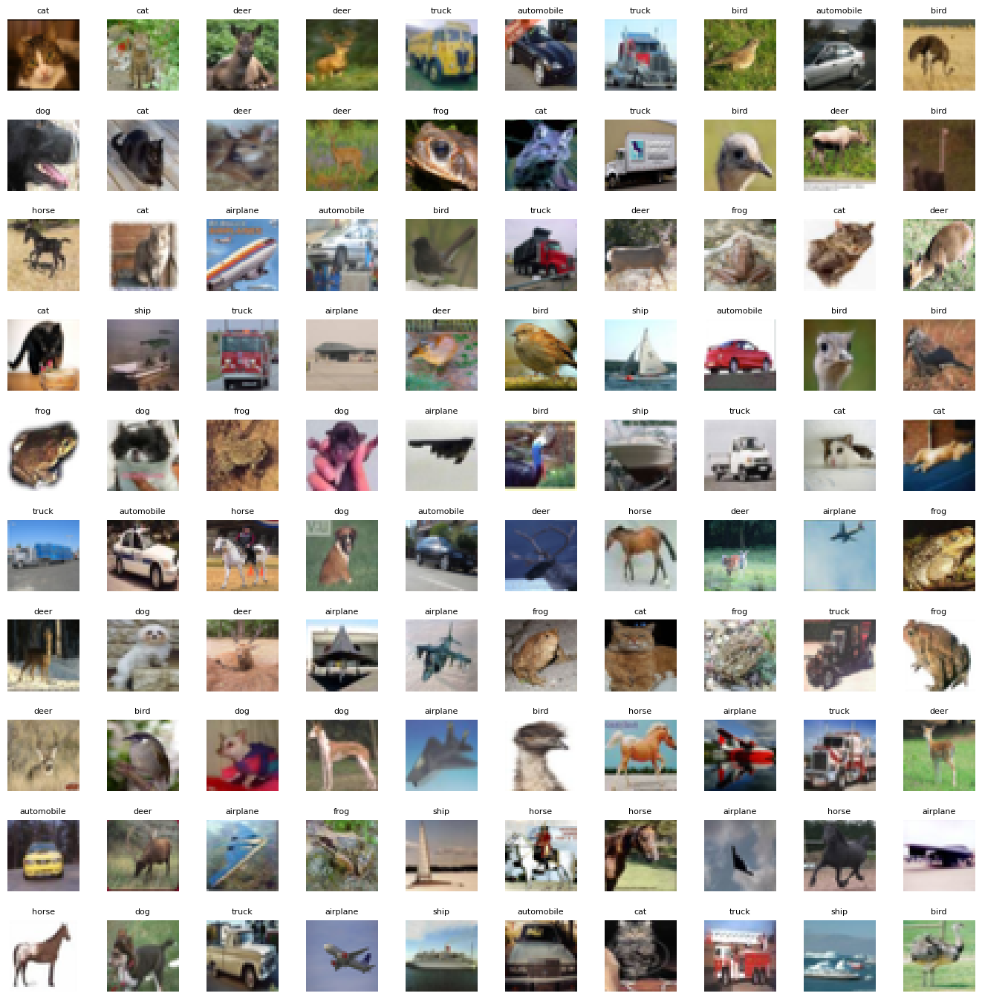

In [5]:
import numpy as np
import matplotlib.pyplot as plt

# CIFAR-10 class labels
labels = ['airplane', 'automobile', 'bird', 'cat', 'deer',
          'dog', 'frog', 'horse', 'ship', 'truck']

# Grid dimensions
W_grid = 10
L_grid = 10

# Number of training samples
n_train = len(X_train)

# Create subplots
fig, axes = plt.subplots(L_grid, W_grid, figsize=(17, 17))
axes = axes.ravel()

# Display random images from X_train and y_train
for i in np.arange(0, W_grid * L_grid):
    index = np.random.randint(0, n_train)

    # Get image and label
    image = X_train[index]
    label = y_train[index]

    # Plot the image
    axes[i].imshow(image)
    axes[i].set_title(labels[label], fontsize=8)
    axes[i].axis('off')

# Adjust layout
plt.subplots_adjust(hspace=0.4)
plt.show()


# 🔄 Data Preprocessing

In [6]:
# CIFAR-10 Class Names
class_names = ['airplane', 'automobile', 'bird', 'cat', 'deer', 'dog', 'frog', 'horse', 'ship', 'truck']

# Hyperparameters
num_epochs = 100
batch_size = 128

# Data augmentation and normalization for CIFAR-10
transform_train = transforms.Compose([
    transforms.Resize((32, 32)), 
    transforms.RandomCrop(32, padding=4),
    transforms.RandomHorizontalFlip(),
    #transforms.RandomRotation(15),
    #transforms.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2),
    transforms.ToTensor(),
    transforms.Normalize((0.4914, 0.4822, 0.4465), (0.2023, 0.1994, 0.2010)),
    #transforms.RandomErasing(p=0.5, scale=(0.02, 0.33), ratio=(0.3, 3.3))
])


transform_test = transforms.Compose([
    transforms.Resize((32, 32)),  # <-- Add this
    transforms.ToTensor(),
    transforms.Normalize((0.4914, 0.4822, 0.4465), (0.2023, 0.1994, 0.2010))
])

transform_val = transforms.Compose([
    transforms.Resize((32, 32)),  # <-- Add this
    transforms.ToTensor(),
    transforms.Normalize((0.4914, 0.4822, 0.4465), (0.2023, 0.1994, 0.2010))
])


# 2. Custom Dataset Wrapper for Transform Support
from torchvision.transforms.functional import to_pil_image

class TransformedDataset(Dataset):
    def __init__(self, images, labels, transform=None):
        self.images = images
        self.labels = labels
        self.transform = transform

    def __getitem__(self, index):
        x = self.images[index]
        y = self.labels[index]

        # If x is a tensor (C, H, W), convert it to PIL
        if isinstance(x, torch.Tensor):
            x = to_pil_image(x)  # converts CHW tensor -> HWC PIL image

        if self.transform:
            x = self.transform(x)

        return x, y

    def __len__(self):
        return len(self.labels)

# 3. Convert NumPy arrays (HWC) to CHW (N, C, H, W)
X_train = np.transpose(X_train, (0, 3, 1, 2))  
X_val   = np.transpose(X_val, (0, 3, 1, 2))
X_test  = np.transpose(X_test, (0, 3, 1, 2))


# 4. Create Dataset Objects
train_dataset = TransformedDataset(torch.tensor(X_train).float(), torch.tensor(y_train).long(), transform=transform_train)
val_dataset   = TransformedDataset(torch.tensor(X_val).float(), torch.tensor(y_val).long(), transform=transform_val)
test_dataset  = TransformedDataset(torch.tensor(X_test).float(), torch.tensor(y_test).long(), transform=transform_test)

# 5. Create Data Loaders
train_loader = DataLoader(train_dataset, batch_size=64, shuffle=True)
val_loader   = DataLoader(val_dataset, batch_size=64, shuffle=False)
test_loader  = DataLoader(test_dataset, batch_size=64, shuffle=False)

# 6. Confirm Everything Loaded
print("Datasets loaded successfully (train, val, test)")
print(f"Train size: {len(train_dataset)} images")
print(f"Validation size: {len(val_dataset)} images")
print(f"Test size: {len(test_dataset)} images")


Datasets loaded successfully (train, val, test)
Train size: 40000 images
Validation size: 10000 images
Test size: 10000 images


# 🤖 Model Building

## CNN MODEL

In [7]:
# Enhanced CNN Model
class CNN(nn.Module):
    def __init__(self):
        super(CNN, self).__init__()
        self.conv1 = nn.Conv2d(3, 64, 3, padding=1)
        self.bn1 = nn.BatchNorm2d(64)
        self.conv2 = nn.Conv2d(64, 128, 3, padding=1)
        self.bn2 = nn.BatchNorm2d(128)
        self.conv3 = nn.Conv2d(128, 256, 3, padding=1)
        self.bn3 = nn.BatchNorm2d(256)
        self.conv4 = nn.Conv2d(256, 512, 3, padding=1)
        self.bn4 = nn.BatchNorm2d(512)
        self.conv5 = nn.Conv2d(512, 512, 3, padding=1)
        self.bn5 = nn.BatchNorm2d(512)
        self.conv6 = nn.Conv2d(512, 512, 3, padding=1)
        self.bn6 = nn.BatchNorm2d(512)
        self.conv7 = nn.Conv2d(512, 512, 3, padding=1)
        self.bn7 = nn.BatchNorm2d(512)
        self.conv8 = nn.Conv2d(512, 512, 3, padding=1)
        self.bn8 = nn.BatchNorm2d(512)

        self.pool = nn.MaxPool2d(2, 2)
        self.relu = nn.ReLU(inplace=True)

        self.fc1 = nn.Linear(512 * 2 * 2, 4096)
        self.bn_fc1 = nn.BatchNorm1d(4096)
        self.dropout1 = nn.Dropout(0.4)
        self.fc2 = nn.Linear(4096, 2048)
        self.bn_fc2 = nn.BatchNorm1d(2048)
        self.dropout2 = nn.Dropout(0.4)
        self.fc3 = nn.Linear(2048, 1024)
        self.bn_fc3 = nn.BatchNorm1d(1024)
        self.dropout3 = nn.Dropout(0.3)
        self.fc4 = nn.Linear(1024, 512)
        self.bn_fc4 = nn.BatchNorm1d(512)
        self.dropout4 = nn.Dropout(0.2)
        self.fc5 = nn.Linear(512, 256)
        self.bn_fc5 = nn.BatchNorm1d(256)
        self.dropout5 = nn.Dropout(0.2)
        self.fc6 = nn.Linear(256, 10)

    def forward(self, x):
        x = self.pool(self.relu(self.bn1(self.conv1(x))))
        x = self.pool(self.relu(self.bn2(self.conv2(x))))
        x = self.pool(self.relu(self.bn3(self.conv3(x))))
        x = self.pool(self.relu(self.bn4(self.conv4(x))))
        x = self.relu(self.bn5(self.conv5(x)))
        x = self.relu(self.bn6(self.conv6(x)))
        x = self.relu(self.bn7(self.conv7(x)))
        x = self.relu(self.bn8(self.conv8(x)))

        x = x.view(-1, 512 * 2 * 2)

        x = self.relu(self.bn_fc1(self.fc1(x)))
        x = self.dropout1(x)
        x = self.relu(self.bn_fc2(self.fc2(x)))
        x = self.dropout2(x)
        x = self.relu(self.bn_fc3(self.fc3(x)))
        x = self.dropout3(x)
        x = self.relu(self.bn_fc4(self.fc4(x)))
        x = self.dropout4(x)
        x = self.relu(self.bn_fc5(self.fc5(x)))
        x = self.dropout5(x)
        x = self.fc6(x)
        return x

## Spectral_CNN MODEL

In [8]:
class CNN_Spectral(nn.Module):
    def __init__(self):
        super(CNN_Spectral, self).__init__()
        self.conv1 = nn.utils.spectral_norm(nn.Conv2d(3, 64, 3, padding=1))
        self.bn1 = nn.BatchNorm2d(64)
        self.conv2 = nn.utils.spectral_norm(nn.Conv2d(64, 128, 3, padding=1))
        self.bn2 = nn.BatchNorm2d(128)
        self.conv3 = nn.utils.spectral_norm(nn.Conv2d(128, 256, 3, padding=1))
        self.bn3 = nn.BatchNorm2d(256)
        self.conv4 = nn.utils.spectral_norm(nn.Conv2d(256, 512, 3, padding=1))
        self.bn4 = nn.BatchNorm2d(512)
        self.conv5 = nn.utils.spectral_norm(nn.Conv2d(512, 512, 3, padding=1))
        self.bn5 = nn.BatchNorm2d(512)
        self.conv6 = nn.utils.spectral_norm(nn.Conv2d(512, 512, 3, padding=1))
        self.bn6 = nn.BatchNorm2d(512)
        self.conv7 = nn.utils.spectral_norm(nn.Conv2d(512, 512, 3, padding=1))
        self.bn7 = nn.BatchNorm2d(512)
        self.conv8 = nn.utils.spectral_norm(nn.Conv2d(512, 512, 3, padding=1))
        self.bn8 = nn.BatchNorm2d(512)

        self.pool = nn.MaxPool2d(2, 2)
        self.relu = nn.ReLU(inplace=True)

        self.fc1 = nn.Linear(512 * 2 * 2, 4096)
        self.bn_fc1 = nn.BatchNorm1d(4096)
        self.dropout1 = nn.Dropout(0.4)
        self.fc2 = nn.Linear(4096, 2048)
        self.bn_fc2 = nn.BatchNorm1d(2048)
        self.dropout2 = nn.Dropout(0.4)
        self.fc3 = nn.Linear(2048, 1024)
        self.bn_fc3 = nn.BatchNorm1d(1024)
        self.dropout3 = nn.Dropout(0.3)
        self.fc4 = nn.Linear(1024, 512)
        self.bn_fc4 = nn.BatchNorm1d(512)
        self.dropout4 = nn.Dropout(0.2)
        self.fc5 = nn.Linear(512, 256)
        self.bn_fc5 = nn.BatchNorm1d(256)
        self.dropout5 = nn.Dropout(0.2)
        self.fc6 = nn.Linear(256, 10)

    def forward(self, x):
        x = self.pool(self.relu(self.bn1(self.conv1(x))))
        x = self.pool(self.relu(self.bn2(self.conv2(x))))
        x = self.pool(self.relu(self.bn3(self.conv3(x))))
        x = self.pool(self.relu(self.bn4(self.conv4(x))))
        x = self.relu(self.bn5(self.conv5(x)))
        x = self.relu(self.bn6(self.conv6(x)))
        x = self.relu(self.bn7(self.conv7(x)))
        x = self.relu(self.bn8(self.conv8(x)))

        x = x.view(-1, 512 * 2 * 2)

        x = self.relu(self.bn_fc1(self.fc1(x)))
        x = self.dropout1(x)
        x = self.relu(self.bn_fc2(self.fc2(x)))
        x = self.dropout2(x)
        x = self.relu(self.bn_fc3(self.fc3(x)))
        x = self.dropout3(x)
        x = self.relu(self.bn_fc4(self.fc4(x)))
        x = self.dropout4(x)
        x = self.relu(self.bn_fc5(self.fc5(x)))
        x = self.dropout5(x)
        x = self.fc6(x)
        return x

## 🧠 Complete Training Pipeline with Visualization, Early Stopping, and Evaluation

In [9]:
class EarlyStopping:
    def __init__(self, patience=7, delta=0, save_path=None):
        self.patience = patience
        self.delta = delta
        self.save_path = save_path
        self.best_loss = float('inf')
        self.counter = 0
        self.early_stop = False
        self.best_model_state = None

    def __call__(self, val_loss, model):
        if val_loss < self.best_loss - self.delta:
            self.best_loss = val_loss
            self.counter = 0
            self.best_model_state = model.state_dict()
            if self.save_path:
                torch.save(self.best_model_state, self.save_path)
        else:
            self.counter += 1
            if self.counter >= self.patience:
                self.early_stop = True

In [10]:
import matplotlib.pyplot as plt
import os

def plot_metrics(train_losses, val_losses, train_accuracies, val_accuracies, model_type="CNN", save_dir="plots"):
    os.makedirs(save_dir, exist_ok=True)
    epochs = range(1, len(train_losses) + 1)

    # Plot Loss
    plt.figure(figsize=(6, 5))
    plt.plot(epochs, train_losses, label='Train Loss')
    plt.plot(epochs, val_losses, label='Validation Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.title(f'Loss Over Epochs - {model_type}')
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    loss_path = os.path.join(save_dir, f"{model_type}_loss.png")
    plt.savefig(loss_path)
    print(f"Loss plot saved as {loss_path}")
    plt.close()

    # Plot Accuracy
    plt.figure(figsize=(6, 5))
    plt.plot(epochs, train_accuracies, label='Train Accuracy')
    plt.plot(epochs, val_accuracies, label='Validation Accuracy')
    plt.xlabel('Epochs')
    plt.ylabel('Accuracy (%)')
    plt.title(f'Accuracy Over Epochs - {model_type}')
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    acc_path = os.path.join(save_dir, f"{model_type}_accuracy.png")
    plt.savefig(acc_path)
    print(f"Accuracy plot saved as {acc_path}")
    plt.close()


In [11]:
# Training Function
def train_model(model, train_loader, val_loader, optimizer, scheduler, criterion, num_epochs, model_name, save_path):
    model.train()
    early_stopping = EarlyStopping(patience=10, save_path=save_path)
    
    # Lists to store metrics for plotting
    train_losses = []
    val_losses = []
    train_accuracies = []
    val_accuracies = []

    for epoch in range(num_epochs):
        running_loss = 0.0
        correct_train = 0
        total_train = 0
        for inputs, labels in train_loader:
            inputs, labels = inputs.to(device), labels.to(device)
            optimizer.zero_grad()
            outputs = model(inputs)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()
            running_loss += loss.item()
            
            # Calculate training accuracy
            _, predicted = torch.max(outputs.data, 1)
            total_train += labels.size(0)
            correct_train += (predicted == labels).sum().item()

        train_loss = running_loss / len(train_loader)
        train_accuracy = 100 * correct_train / total_train
        train_losses.append(train_loss)
        train_accuracies.append(train_accuracy)

        # Validation step
        model.eval()
        val_loss = 0.0
        correct_val = 0
        total_val = 0
        with torch.no_grad():
            for inputs, labels in val_loader:
                inputs, labels = inputs.to(device), labels.to(device)
                outputs = model(inputs)
                loss = criterion(outputs, labels)
                val_loss += loss.item()
                
                # Calculate validation accuracy
                _, predicted = torch.max(outputs.data, 1)
                total_val += labels.size(0)
                correct_val += (predicted == labels).sum().item()

        val_loss = val_loss / len(val_loader)
        val_accuracy = 100 * correct_val / total_val
        val_losses.append(val_loss)
        val_accuracies.append(val_accuracy)

        print(f'{model_name} Epoch {epoch+1}, Train Loss: {train_loss:.3f}, Train Accuracy: {train_accuracy:.2f}%')
        print(f'{model_name} Epoch {epoch+1}, Validation Loss: {val_loss:.3f}, Validation Accuracy: {val_accuracy:.2f}%')

        scheduler.step(val_loss)

        # Call updated EarlyStopping with model
        early_stopping(val_loss, model)

        if early_stopping.early_stop:
            print(f"{model_name} Early stopping triggered after epoch {epoch+1}")
            # Load best model state before breaking
            if early_stopping.best_model_state:
                model.load_state_dict(early_stopping.best_model_state)
            break
        model.train()

    # Return final training accuracy after training
    train_accuracy = 100 * correct_train / total_train
    print(f'\n{model_name} Final Training Accuracy: {train_accuracy:.2f}%')
    
    plot_metrics(train_losses, val_losses, train_accuracies, val_accuracies, model_type=model_name)
    return model, train_losses, val_losses, train_accuracies, val_accuracies


In [12]:
# Evaluation Function
def evaluate_model(model, test_loader, criterion, model_name, class_names=None):
    model.eval()
    correct = 0
    total = 0
    test_loss = 0.0
    all_preds = []
    all_labels = []

    with torch.no_grad():
        for inputs, labels in test_loader:
            inputs, labels = inputs.to(device), labels.to(device)
            outputs = model(inputs)
            loss = criterion(outputs, labels)
            test_loss += loss.item()
            _, predicted = torch.max(outputs.data, 1)
            total += labels.size(0)
            correct += (predicted == labels).sum().item()
            all_preds.extend(predicted.cpu().numpy())
            all_labels.extend(labels.cpu().numpy())

    test_loss = test_loss / len(test_loader)
    test_accuracy = 100 * correct / total
    print(f'\n{model_name} Test Set Results:')
    print(f'Test Loss: {test_loss:.3f}')
    print(f'Test Accuracy: {test_accuracy:.2f}%')

    # Generate confusion matrix
    cm = confusion_matrix(all_labels, all_preds)
    print(f'Confusion Matrix for {model_name}:')

    # Display confusion matrix with labels (if class names are provided)
    if class_names:
        cm_display = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_names)
    else:
        cm_display = ConfusionMatrixDisplay(confusion_matrix=cm)

    # Plot and save the confusion matrix
    fig, ax = plt.subplots(figsize=(8, 6))
    cm_display.plot(cmap=plt.cm.Blues, ax=ax, xticks_rotation=45)
    plt.title(f'{model_name} Confusion Matrix')
    plt.tight_layout()
    plt.savefig(f'{model_name.lower()}_confusion_matrix.png')
    print(f"Confusion matrix saved as {model_name.lower()}_confusion_matrix.png")
    plt.show()


    # Optionally print the classification report with class labels
    print("\nClassification Report:")
    print(classification_report(all_labels, all_preds, target_names=class_names))

    return test_loss, test_accuracy, cm  # Return the test loss, accuracy, and confusion matrix

## 🚀 Model Initialization, Training, and Final Evaluation for CNN

In [13]:
# Initialize model, loss, optimizer, and scheduler
criterion = nn.CrossEntropyLoss()

model_CNN = CNN().to(device)
optimizer_cnn = optim.SGD(model_CNN.parameters(), lr=0.01, momentum=0.9)
scheduler_cnn = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer_cnn, 'min', patience=5, verbose=True)

/home/lab-01/.local/lib/python3.12/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


In [14]:
# Train and Evaluate CNN
print("Training CNN...")
model_CNN, cnn_train_losses, cnn_val_losses, cnn_train_accs, cnn_val_accs = train_model(
    model_CNN,
    train_loader,
    val_loader,
    optimizer_cnn,
    scheduler_cnn,
    criterion,
    num_epochs,
    'CNN',
    'cnn_model.pth'
)

Training CNN...
CNN Epoch 1, Train Loss: 1.804, Train Accuracy: 29.02%
CNN Epoch 1, Validation Loss: 1.765, Validation Accuracy: 35.04%
CNN Epoch 2, Train Loss: 1.532, Train Accuracy: 41.14%
CNN Epoch 2, Validation Loss: 1.404, Validation Accuracy: 47.79%
CNN Epoch 3, Train Loss: 1.359, Train Accuracy: 49.17%
CNN Epoch 3, Validation Loss: 1.192, Validation Accuracy: 55.26%
CNN Epoch 4, Train Loss: 1.201, Train Accuracy: 55.74%
CNN Epoch 4, Validation Loss: 1.060, Validation Accuracy: 61.21%
CNN Epoch 5, Train Loss: 1.098, Train Accuracy: 60.53%
CNN Epoch 5, Validation Loss: 0.960, Validation Accuracy: 65.42%
CNN Epoch 6, Train Loss: 1.009, Train Accuracy: 64.29%
CNN Epoch 6, Validation Loss: 1.234, Validation Accuracy: 56.83%
CNN Epoch 7, Train Loss: 0.944, Train Accuracy: 66.57%
CNN Epoch 7, Validation Loss: 0.852, Validation Accuracy: 69.64%
CNN Epoch 8, Train Loss: 0.894, Train Accuracy: 68.63%
CNN Epoch 8, Validation Loss: 0.857, Validation Accuracy: 70.53%
CNN Epoch 9, Train Loss:


CNN Test Set Results:
Test Loss: 0.409
Test Accuracy: 88.34%
Confusion Matrix for CNN:
Confusion matrix saved as cnn_confusion_matrix.png


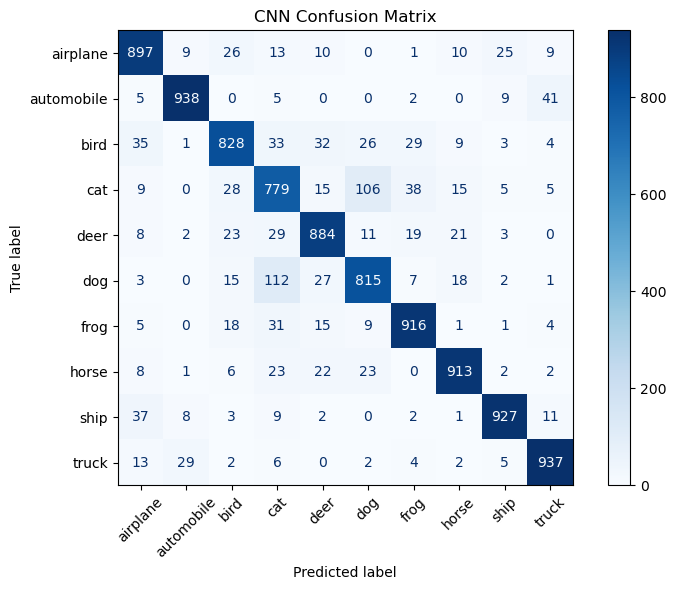


Classification Report:
              precision    recall  f1-score   support

    airplane       0.88      0.90      0.89      1000
  automobile       0.95      0.94      0.94      1000
        bird       0.87      0.83      0.85      1000
         cat       0.75      0.78      0.76      1000
        deer       0.88      0.88      0.88      1000
         dog       0.82      0.81      0.82      1000
        frog       0.90      0.92      0.91      1000
       horse       0.92      0.91      0.92      1000
        ship       0.94      0.93      0.94      1000
       truck       0.92      0.94      0.93      1000

    accuracy                           0.88     10000
   macro avg       0.88      0.88      0.88     10000
weighted avg       0.88      0.88      0.88     10000


Final Test Accuracy of CNN Model: 88.34%


In [15]:
# Now evaluate the model's performance on the test set
# CIFAR-10 class names
cifar10_classes = ['airplane', 'automobile', 'bird', 'cat', 'deer', 
                   'dog', 'frog', 'horse', 'ship', 'truck']

# Evaluate model
test_loss, test_accuracy, cm = evaluate_model(model_CNN, test_loader, criterion, 'CNN', class_names=cifar10_classes)

# Print the final test accuracy
print(f'\nFinal Test Accuracy of CNN Model: {test_accuracy:.2f}%')

## 🚀 Model Initialization, Training, and Final Evaluation for Spectral_CNN Model

In [16]:
# Train and Evaluate CNN_Spectral
model_spectral = CNN_Spectral().to(device)
optimizer_spectral = optim.SGD(model_spectral.parameters(), lr=0.01, momentum=0.9)
scheduler_spectral= torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer_spectral, 'min', patience=5, verbose=True)

/home/lab-01/.local/lib/python3.12/site-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


In [17]:
# Train the model and get the results
print("\nTraining CNN_Spectral from scratch...")
model_spectral, train_losses, val_losses, train_accuracies, val_accuracies = train_model(
    model_spectral, 
    train_loader, 
    val_loader, 
    optimizer_spectral, 
    scheduler_spectral, 
    criterion, 
    num_epochs, 
    model_name='CNN_Spectral', 
    save_path='cnn_spectral.pth'
)


Training CNN_Spectral from scratch...
CNN_Spectral Epoch 1, Train Loss: 1.813, Train Accuracy: 28.77%
CNN_Spectral Epoch 1, Validation Loss: 1.625, Validation Accuracy: 35.24%
CNN_Spectral Epoch 2, Train Loss: 1.509, Train Accuracy: 41.91%
CNN_Spectral Epoch 2, Validation Loss: 1.421, Validation Accuracy: 45.79%
CNN_Spectral Epoch 3, Train Loss: 1.315, Train Accuracy: 50.99%
CNN_Spectral Epoch 3, Validation Loss: 1.228, Validation Accuracy: 55.02%
CNN_Spectral Epoch 4, Train Loss: 1.168, Train Accuracy: 57.52%
CNN_Spectral Epoch 4, Validation Loss: 1.133, Validation Accuracy: 57.78%
CNN_Spectral Epoch 5, Train Loss: 1.075, Train Accuracy: 61.14%
CNN_Spectral Epoch 5, Validation Loss: 1.032, Validation Accuracy: 63.64%
CNN_Spectral Epoch 6, Train Loss: 0.986, Train Accuracy: 65.01%
CNN_Spectral Epoch 6, Validation Loss: 0.868, Validation Accuracy: 68.82%
CNN_Spectral Epoch 7, Train Loss: 0.931, Train Accuracy: 67.09%
CNN_Spectral Epoch 7, Validation Loss: 1.071, Validation Accuracy: 64


CNN_Spectral Test Set Results:
Test Loss: 0.394
Test Accuracy: 87.96%
Confusion Matrix for CNN_Spectral:
Confusion matrix saved as cnn_spectral_confusion_matrix.png


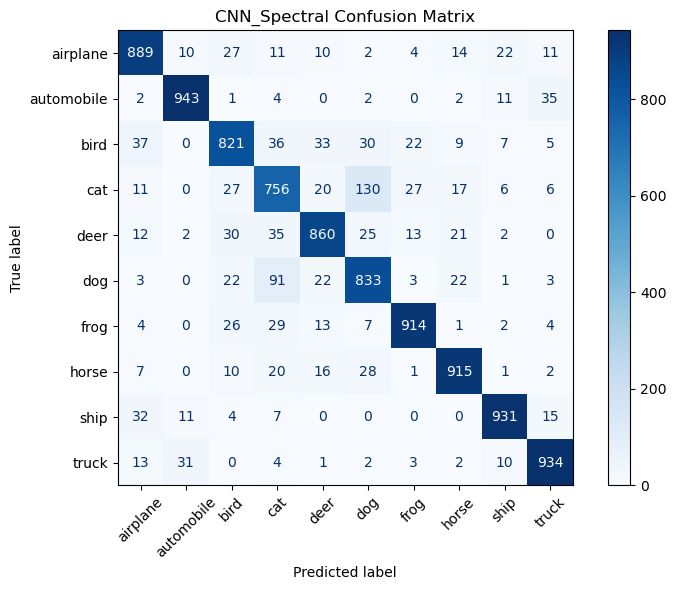


Classification Report:
              precision    recall  f1-score   support

    airplane       0.88      0.89      0.88      1000
  automobile       0.95      0.94      0.94      1000
        bird       0.85      0.82      0.83      1000
         cat       0.76      0.76      0.76      1000
        deer       0.88      0.86      0.87      1000
         dog       0.79      0.83      0.81      1000
        frog       0.93      0.91      0.92      1000
       horse       0.91      0.92      0.91      1000
        ship       0.94      0.93      0.93      1000
       truck       0.92      0.93      0.93      1000

    accuracy                           0.88     10000
   macro avg       0.88      0.88      0.88     10000
weighted avg       0.88      0.88      0.88     10000


Final Test Accuracy of Spectral_CNN Model: 87.96%


In [18]:
# Now evaluate the model's performance on the test set
test_loss, test_accuracy, cm = evaluate_model(model_spectral, test_loader, criterion, 'CNN_Spectral',class_names=cifar10_classes)

# Print the final test accuracy
print(f'\nFinal Test Accuracy of Spectral_CNN Model: {test_accuracy:.2f}%')

# 🧪 Testing Robustness: Overconfidence Evaluation on Random Noise Inputs - CNN & Spectral

In [19]:
import matplotlib.pyplot as plt
from collections import Counter
def find_adversarial_examples(model, transform_test, num_attempts=10000, seed=42):
    torch.manual_seed(seed)
    np.random.seed(seed)
    random.seed(seed)
    if torch.cuda.is_available():
        torch.cuda.manual_seed_all(seed)

    model.eval()
    N = 0
    T = num_attempts
    successful_images = []
    adv_features = []
    adv_labels = []
    class_counts = Counter()

    for i in range(T):
        noise_image = torch.rand(1, 3, 32, 32)  # [0, 1]
        noise_image = noise_image.squeeze(0).permute(1, 2, 0).numpy()  # To HWC
        noise_image = (noise_image * 255).astype(np.uint8)  # To uint8
        noise_image = Image.fromarray(noise_image)
        noise_image = transform_test(noise_image).unsqueeze(0).to(device)

        # Get model prediction with no gradient computation
        with torch.no_grad():
            output = model(noise_image)
            probabilities = F.softmax(output, dim=1)
            max_prob, predicted = torch.max(probabilities, dim=1)

            # If confidence is >= 0.9, record the image and class
            if max_prob.item() >= 0.9:
                N += 1
                class_name = class_names[predicted.item()]
                successful_images.append((noise_image.cpu(), predicted.item(), max_prob.item()))
                class_counts[class_name] += 1
                adv_features.append(output.view(output.size(0), -1).cpu().numpy())  # Get the feature vector
                adv_labels.append(predicted.item())  # Store predicted class
                print(f'Adversarial example {N}: {class_name}, Confidence {max_prob.item():.3f}')

    print(f'Found {N} adversarial examples out of {T} attempts.')
    return N, T, successful_images, class_counts, np.vstack(adv_features), np.array(adv_labels)

### Adversarial examples for CNN

In [20]:
# Example call to find adversarial examples
print("Finding adversarial examples for CNN...")
N, T, adv_examples, class_counts, adv_features, adv_labels = find_adversarial_examples(model_CNN, transform_test)

Finding adversarial examples for CNN...
Adversarial example 1: frog, Confidence 0.973
Adversarial example 2: frog, Confidence 0.986
Adversarial example 3: cat, Confidence 0.909
Adversarial example 4: cat, Confidence 0.954
Adversarial example 5: cat, Confidence 0.949
Adversarial example 6: frog, Confidence 0.906
Adversarial example 7: cat, Confidence 0.949
Adversarial example 8: cat, Confidence 0.951
Adversarial example 9: cat, Confidence 0.972
Adversarial example 10: frog, Confidence 0.938
Adversarial example 11: frog, Confidence 0.944
Adversarial example 12: frog, Confidence 0.924
Adversarial example 13: frog, Confidence 0.961
Adversarial example 14: frog, Confidence 0.955
Adversarial example 15: frog, Confidence 0.933
Adversarial example 16: frog, Confidence 0.930
Adversarial example 17: cat, Confidence 0.971
Adversarial example 18: frog, Confidence 0.951
Adversarial example 19: frog, Confidence 0.986
Adversarial example 20: bird, Confidence 0.917
Adversarial example 21: cat, Confide

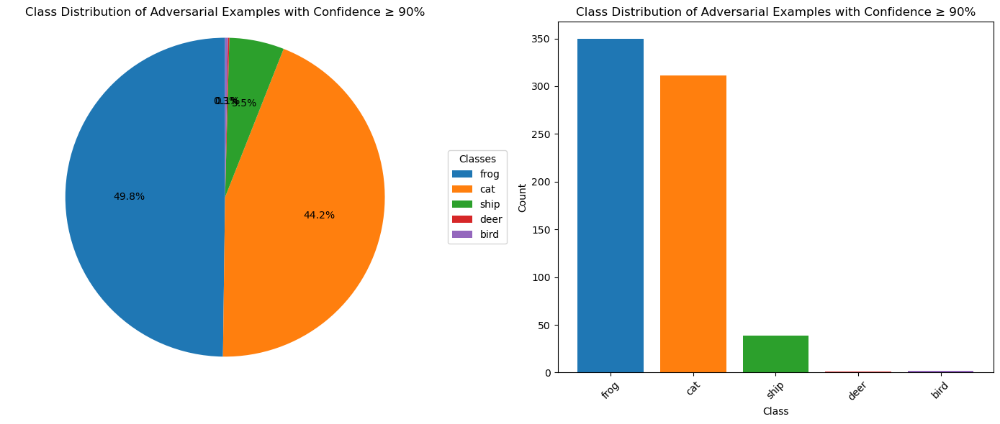

In [21]:
from collections import Counter
import matplotlib.pyplot as plt

# Sort the adversarial examples for plotting
adv_examples_sorted = sorted(adv_examples, key=lambda x: x[2], reverse=True)

# Count the occurrences of each class
class_counts = Counter([class_names[predicted_class] for _, predicted_class, _ in adv_examples_sorted])

# Get class labels and values
class_labels = list(class_counts.keys())
class_values = list(class_counts.values())

# Create a figure with 1 row and 2 columns
plt.figure(figsize=(14, 6))  # Set the overall figure size

# Pie chart
plt.subplot(1, 2, 1)
wedges, texts, autotexts = plt.pie(
    class_values,
    autopct='%1.1f%%',
    startangle=90
)
plt.title('Class Distribution of Adversarial Examples with Confidence ≥ 90%')
plt.axis('equal')

# Add legend to the right of the pie chart
plt.legend(wedges, class_labels, title="Classes", loc="center left", bbox_to_anchor=(1, 0, 0.5, 1))

# Extract colors from pie wedges
colors = [w.get_facecolor() for w in wedges]

# Bar plot with matching colors
plt.subplot(1, 2, 2)
plt.bar(class_labels, class_values, color=colors)
plt.title('Class Distribution of Adversarial Examples with Confidence ≥ 90%')
plt.xlabel('Class')
plt.ylabel('Count')
plt.xticks(rotation=45)

# Display the plots
plt.tight_layout()
plt.show()

### 🔍 Top-5 High-Confidence Adversarial Examples Detected by CNN

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


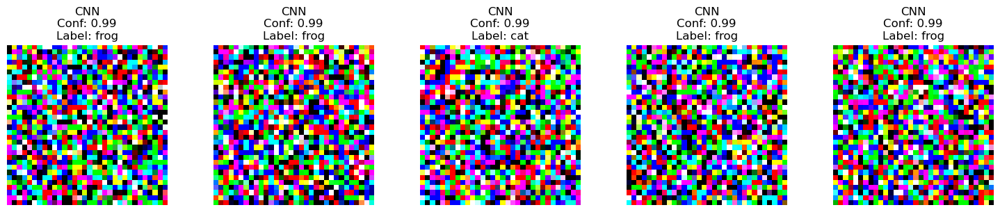

In [22]:
def plot_topk_adversarials(successful_images, model_name, k=5):
    if len(successful_images) == 0:
        print("No adversarial examples to display.")
        return

    # Unpack and prepare the data
    images = [img.squeeze(0).cpu().numpy() for img, _, _ in successful_images]
    confidences = [conf for _, _, conf in successful_images]
    labels = [class_names[label] for _, label, _ in successful_images]

    # Get top-k indices based on confidence
    topk_indices = np.argsort(confidences)[-k:][::-1]
    topk_images = [images[i] for i in topk_indices]
    topk_confidences = [confidences[i] for i in topk_indices]
    topk_labels = [labels[i] for i in topk_indices]

    # Plotting
    plt.figure(figsize=(15, 3))
    for i in range(len(topk_images)):
        img = np.transpose(topk_images[i], (1, 2, 0))  # CHW -> HWC
        plt.subplot(1, k, i + 1)
        plt.imshow(img)
        plt.title(f'{model_name}\nConf: {topk_confidences[i]:.2f}\nLabel: {topk_labels[i]}')
        plt.axis('off')

    plt.tight_layout()
    plt.show()

plot_topk_adversarials(adv_examples, model_name="CNN", k=5)

### 🌐 t-SNE Visualization of CNN Features: Clean vs. Adversarial Inputs

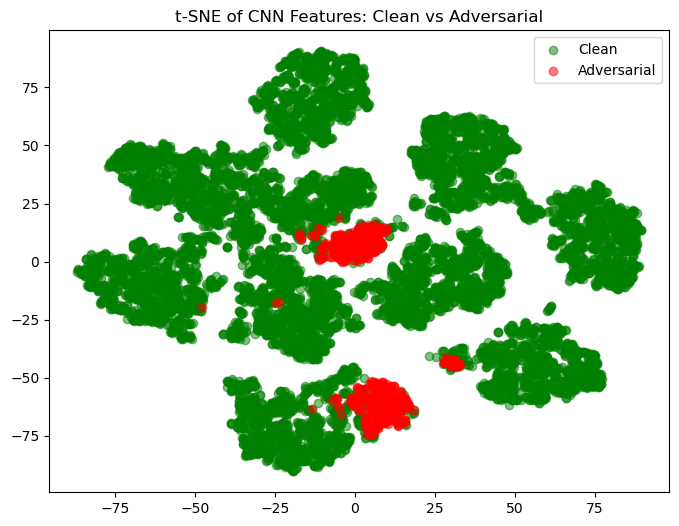

In [23]:
from sklearn.manifold import TSNE

# Define the function to extract features from the model (before the final layer)
def extract_features(model, data_loader, device):
    model.eval()
    features = []
    labels = []
    with torch.no_grad():
        for inputs, targets in data_loader:
            inputs = inputs.to(device)
            outputs = model(inputs)
            features.append(outputs.view(outputs.size(0), -1).cpu().numpy())  # Flatten features
            labels.append(targets.cpu().numpy())
    return np.vstack(features), np.concatenate(labels)
    
# Assuming 'test_loader' is the DataLoader for the clean test set
clean_features, clean_labels = extract_features(model_CNN, test_loader, device)

# Now apply t-SNE
tsne = TSNE(n_components=2, perplexity=30)
X_proj = tsne.fit_transform(np.vstack([clean_features, adv_features]))
y_combined = np.concatenate([clean_labels, adv_labels])

# Plotting
plt.figure(figsize=(8, 6))
plt.scatter(X_proj[:len(clean_features), 0], X_proj[:len(clean_features), 1], c='green', label='Clean', alpha=0.5)
plt.scatter(X_proj[len(clean_features):, 0], X_proj[len(clean_features):, 1], c='red', label='Adversarial', alpha=0.5)
plt.legend()
plt.title("t-SNE of CNN Features: Clean vs Adversarial")
plt.show()


### 📊 Layer-wise Spectral Norm Analysis of Spectral_CNN Model

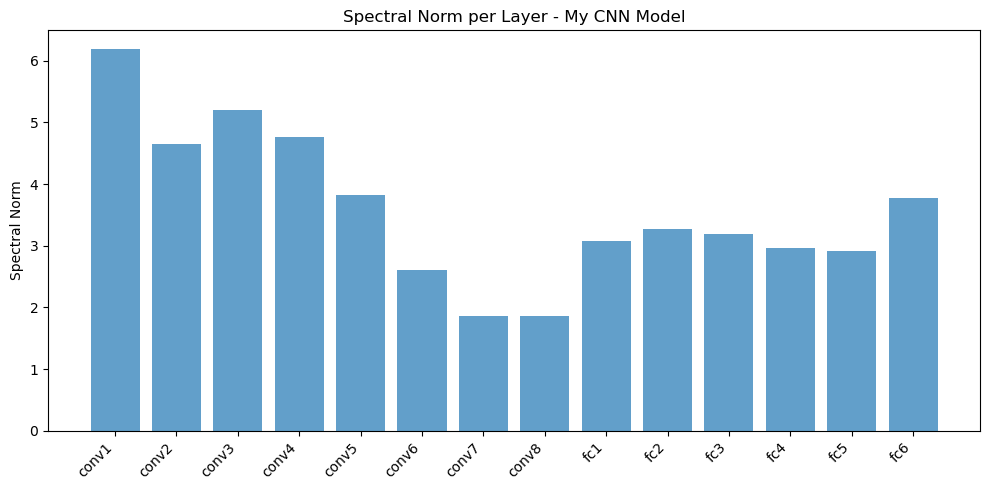

In [24]:
import torch
from torch.nn.utils import spectral_norm

def plot_layerwise_spectral_norm(model_CNN, model_name="CNN"):
    norms = []
    layer_names = []

    for name, module in model_CNN.named_modules():
        if isinstance(module, (torch.nn.Conv2d, torch.nn.Linear)):
            try:
                w = module.weight.data
                # Spectral norm = largest singular value
                u, s, v = torch.svd(w.view(w.size(0), -1))
                norms.append(s[0].item())
                layer_names.append(name)
            except Exception as e:
                print(f"Skipping {name}: {e}")

    plt.figure(figsize=(10, 5))
    plt.bar(range(len(norms)), norms, tick_label=layer_names, alpha=0.7)
    plt.title(f"Spectral Norm per Layer - {model_name}")
    plt.ylabel("Spectral Norm")
    plt.xticks(rotation=45, ha='right')
    plt.tight_layout()
    plt.show()

# Assuming your CNN model is called 'model_CNN'
plot_layerwise_spectral_norm(model_CNN, model_name="My CNN Model")

### 📊 Confidence Score Distribution: Clean vs. Adversarial Predictions (CNN)

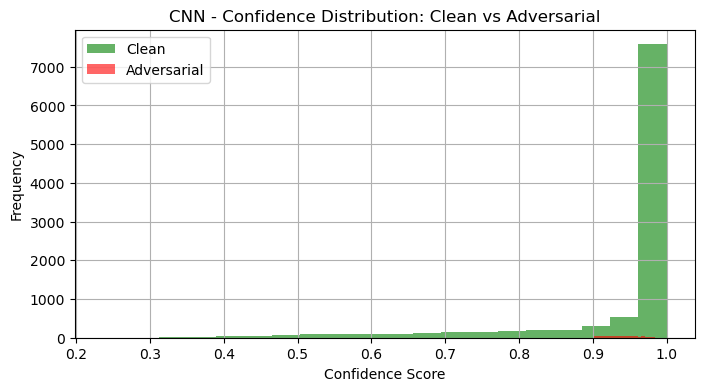

In [25]:
import matplotlib.pyplot as plt
import torch
import torch.nn.functional as F
from collections import Counter

def plot_confidence_histogram(clean_conf, adv_conf, model_name="CNN"):
    plt.figure(figsize=(8, 4))
    plt.hist(clean_conf, bins=20, alpha=0.6, label='Clean', color='green')
    plt.hist(adv_conf, bins=20, alpha=0.6, label='Adversarial', color='red')
    plt.xlabel("Confidence Score")
    plt.ylabel("Frequency")
    plt.title(f"{model_name} - Confidence Distribution: Clean vs Adversarial")
    plt.legend()
    plt.grid(True)
    plt.show()

# Assuming 'test_loader' is your DataLoader for clean examples
clean_examples_CNN = []
model_CNN.eval()
with torch.no_grad():
    for inputs, targets in test_loader:
        inputs = inputs.to(device)
        outputs = model_CNN(inputs)
        probabilities = F.softmax(outputs, dim=1)
        max_prob, predicted = torch.max(probabilities, dim=1)
        for i in range(len(inputs)):
            clean_examples_CNN.append((inputs[i], predicted[i], max_prob[i]))

# Use the adv_features and adv_labels returned by the find_adversarial_examples function
adv_conf_CNN = [max_prob for _, _, max_prob in adv_examples]

# Extract confidence scores from clean examples for plotting the histogram
clean_conf_CNN = [max_prob.item() for _, _, max_prob in clean_examples_CNN]

# Call the plot function for CNN
plot_confidence_histogram(clean_conf_CNN, adv_conf_CNN, model_name="CNN")

### Gradient Visualization of Adversarial Perturbation

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


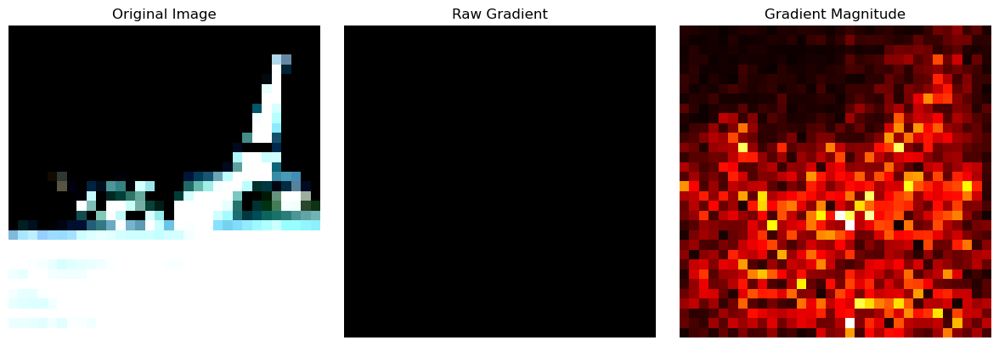

In [26]:
import torch
import torchvision.transforms as transforms
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image

def visualize_adversarial_gradient(model, image, label, epsilon=0.03, device='cuda'):
    model.eval()
    image = image.unsqueeze(0).to(device).requires_grad_(True)
    label = torch.tensor([label]).to(device)

    # Forward pass to compute the output of the model
    output = model(image)
    
    # Compute the loss using CrossEntropy
    loss = torch.nn.CrossEntropyLoss()(output, label)
    
    # Backpropagate the gradients
    loss.backward()

    # Get the gradient data and calculate gradient magnitude
    gradient = image.grad.data.squeeze().cpu().numpy()
    grad_magnitude = np.linalg.norm(gradient, axis=0)

    # Plotting the original image, gradient, and gradient magnitude
    plt.figure(figsize=(12, 4))
    
    # Original Image
    plt.subplot(1, 3, 1)
    plt.imshow(image.detach().squeeze().cpu().permute(1, 2, 0))  # Convert from CHW to HWC
    plt.title("Original Image")
    plt.axis("off")
    
    # Raw Gradient
    plt.subplot(1, 3, 2)
    plt.imshow(gradient.transpose(1, 2, 0))  # Transpose for proper visualization
    plt.title("Raw Gradient")
    plt.axis("off")

    # Gradient Magnitude
    plt.subplot(1, 3, 3)
    plt.imshow(grad_magnitude, cmap='hot')
    plt.title("Gradient Magnitude")
    plt.axis("off")
    
    plt.tight_layout()
    plt.show()

# Example image and label (from your dataset or adversarial example)
image = test_dataset[0][0]  # Example image from test dataset
label = test_dataset[0][1]  # Example label from test dataset

visualize_adversarial_gradient(model_CNN, image, label, device='cuda')

### Adversarial examples for Spectral_CNN

In [27]:
# Call the find_adversarial_examples function with model_spectral
print("Finding adversarial examples for Spectral_CNN...")
N_spectral, T_spectral, adv_examples_spectral, class_counts_spectral, adv_features_spectral, adv_labels_spectral = find_adversarial_examples(model_spectral, transform_test)

Finding adversarial examples for Spectral_CNN...
Adversarial example 1: deer, Confidence 0.943
Adversarial example 2: frog, Confidence 0.923
Adversarial example 3: deer, Confidence 0.949
Adversarial example 4: deer, Confidence 0.935
Adversarial example 5: frog, Confidence 0.929
Adversarial example 6: deer, Confidence 0.935
Adversarial example 7: deer, Confidence 0.969
Adversarial example 8: deer, Confidence 0.933
Adversarial example 9: deer, Confidence 0.929
Adversarial example 10: frog, Confidence 0.932
Adversarial example 11: deer, Confidence 0.913
Adversarial example 12: cat, Confidence 0.907
Adversarial example 13: deer, Confidence 0.949
Adversarial example 14: frog, Confidence 0.911
Adversarial example 15: frog, Confidence 0.942
Adversarial example 16: ship, Confidence 0.902
Adversarial example 17: deer, Confidence 0.945
Adversarial example 18: deer, Confidence 0.914
Adversarial example 19: deer, Confidence 0.910
Adversarial example 20: deer, Confidence 0.903
Adversarial example 2

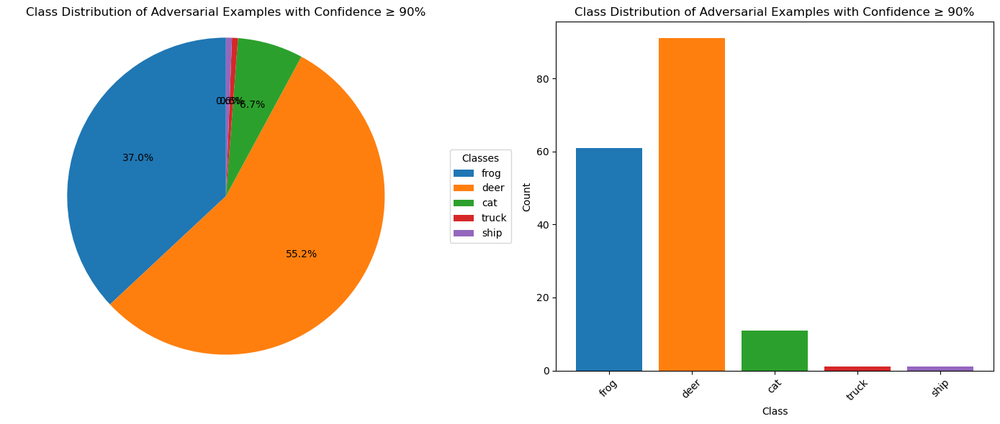

In [28]:
from collections import Counter
import matplotlib.pyplot as plt

# Sort the adversarial examples for plotting
adv_examples_sorted = sorted(adv_examples_spectral, key=lambda x: x[2], reverse=True)

# Count the occurrences of each class
class_counts_spectral = Counter([class_names[predicted_class] for _, predicted_class, _ in adv_examples_sorted])

# Get class labels and counts
class_labels = list(class_counts_spectral.keys())
class_values = list(class_counts_spectral.values())

# Create a figure with 1 row and 2 columns
plt.figure(figsize=(14, 6))  # Set the overall figure size

# Pie chart
plt.subplot(1, 2, 1)
wedges, texts, autotexts = plt.pie(
    class_values,
    autopct='%1.1f%%',
    startangle=90
)
plt.title('Class Distribution of Adversarial Examples with Confidence ≥ 90%')
plt.axis('equal')

# Add legend on the right
plt.legend(wedges, class_labels, title="Classes", loc="center left", bbox_to_anchor=(1, 0, 0.5, 1))

# Extract colors from pie wedges
colors = [w.get_facecolor() for w in wedges]

# Bar plot with matching colors
plt.subplot(1, 2, 2)
plt.bar(class_labels, class_values, color=colors)
plt.title('Class Distribution of Adversarial Examples with Confidence ≥ 90%')
plt.xlabel('Class')
plt.ylabel('Count')
plt.xticks(rotation=45)

# Display the plots
plt.tight_layout()
plt.show()

### 🔍 Top-5 High-Confidence Adversarial Examples Detected by CNN

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


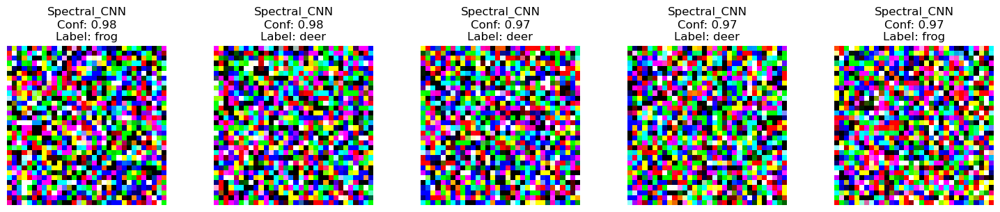

In [29]:
def plot_topk_adversarials(successful_images, model_name, k=5):
    if len(successful_images) == 0:
        print("No adversarial examples to display.")
        return

    # Unpack and prepare the data
    images = [img.squeeze(0).cpu().numpy() for img, _, _ in successful_images]
    confidences = [conf for _, _, conf in successful_images]
    labels = [class_names[label] for _, label, _ in successful_images]

    # Get top-k indices based on confidence
    topk_indices = np.argsort(confidences)[-k:][::-1]
    topk_images = [images[i] for i in topk_indices]
    topk_confidences = [confidences[i] for i in topk_indices]
    topk_labels = [labels[i] for i in topk_indices]

    # Plotting
    plt.figure(figsize=(15, 3))
    for i in range(len(topk_images)):
        img = np.transpose(topk_images[i], (1, 2, 0))  # CHW -> HWC
        plt.subplot(1, k, i + 1)
        plt.imshow(img)
        plt.title(f'{model_name}\nConf: {topk_confidences[i]:.2f}\nLabel: {topk_labels[i]}')
        plt.axis('off')

    plt.tight_layout()
    plt.show()

plot_topk_adversarials(adv_examples_spectral, model_name="Spectral_CNN", k=5)

### 🌐 t-SNE Visualization of CNN Features: Clean vs. Adversarial Inputs

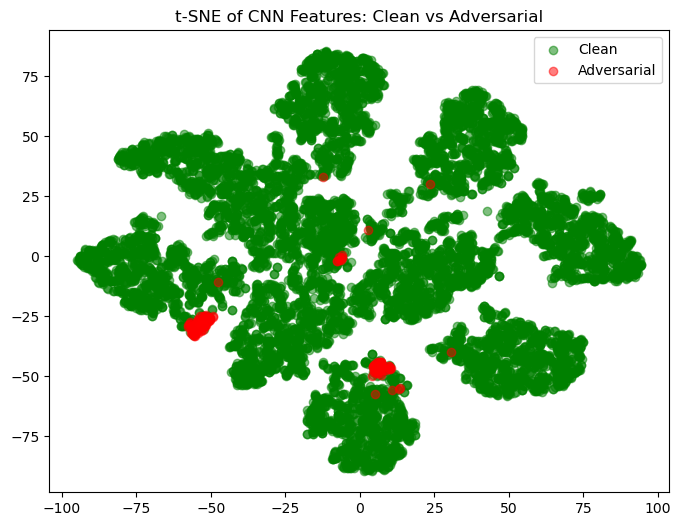

In [30]:
from sklearn.manifold import TSNE

# Define the function to extract features from the model (before the final layer)
def extract_features(model, data_loader, device):
    model.eval()
    features = []
    labels = []
    with torch.no_grad():
        for inputs, targets in data_loader:
            inputs = inputs.to(device)
            outputs = model(inputs)
            features.append(outputs.view(outputs.size(0), -1).cpu().numpy())  # Flatten features
            labels.append(targets.cpu().numpy())
    return np.vstack(features), np.concatenate(labels)
    
# Assuming 'test_loader' is the DataLoader for the clean test set
clean_features, clean_labels = extract_features(model_spectral, test_loader, device)

# Now apply t-SNE
tsne = TSNE(n_components=2, perplexity=30)
X_proj = tsne.fit_transform(np.vstack([clean_features, adv_features_spectral]))
y_combined = np.concatenate([clean_labels, adv_labels_spectral])

# Plotting
plt.figure(figsize=(8, 6))
plt.scatter(X_proj[:len(clean_features), 0], X_proj[:len(clean_features), 1], c='green', label='Clean', alpha=0.5)
plt.scatter(X_proj[len(clean_features):, 0], X_proj[len(clean_features):, 1], c='red', label='Adversarial', alpha=0.5)
plt.legend()
plt.title("t-SNE of CNN Features: Clean vs Adversarial")
plt.show()


### 📊 Layer-wise Spectral Norm Analysis of Spectral_CNN Model

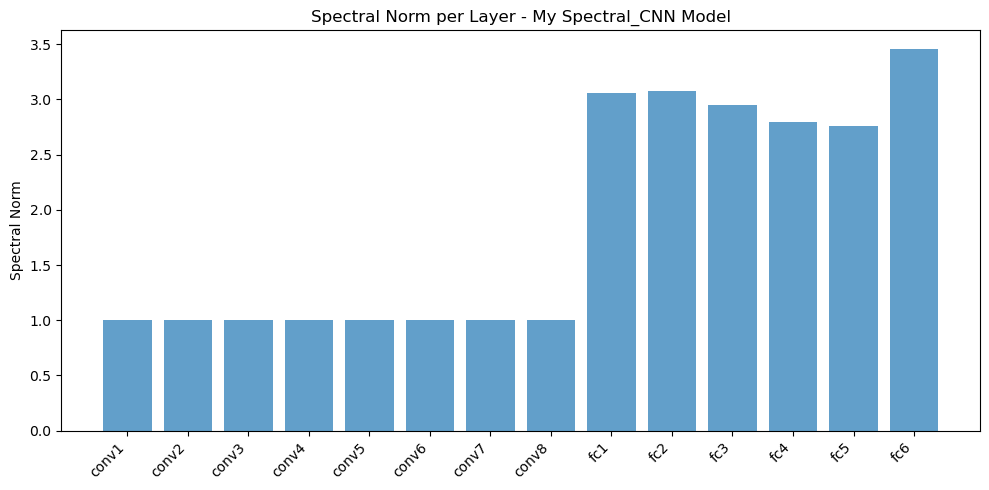

In [31]:
import torch
from torch.nn.utils import spectral_norm

def plot_layerwise_spectral_norm(model_spectral, model_name="Spectral_CNN"):
    norms = []
    layer_names = []

    for name, module in model_spectral.named_modules():
        if isinstance(module, (torch.nn.Conv2d, torch.nn.Linear)):
            try:
                w = module.weight.data
                # Spectral norm = largest singular value
                u, s, v = torch.svd(w.view(w.size(0), -1))
                norms.append(s[0].item())
                layer_names.append(name)
            except Exception as e:
                print(f"Skipping {name}: {e}")

    plt.figure(figsize=(10, 5))
    plt.bar(range(len(norms)), norms, tick_label=layer_names, alpha=0.7)
    plt.title(f"Spectral Norm per Layer - {model_name}")
    plt.ylabel("Spectral Norm")
    plt.xticks(rotation=45, ha='right')
    plt.tight_layout()
    plt.show()

plot_layerwise_spectral_norm(model_spectral, model_name="My Spectral_CNN Model")

### 📊 Confidence Score Distribution: Clean vs. Adversarial Predictions Soectral_CNN

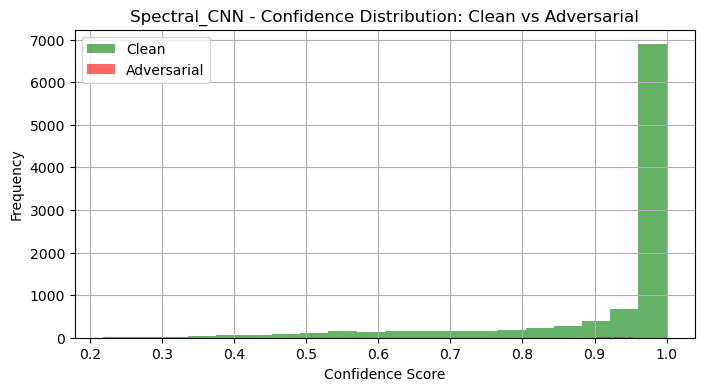

In [32]:
import matplotlib.pyplot as plt
import torch
import torch.nn.functional as F
from collections import Counter

def plot_confidence_histogram(clean_conf, adv_conf, model_name="Spectral_CNN"):
    plt.figure(figsize=(8, 4))
    plt.hist(clean_conf, bins=20, alpha=0.6, label='Clean', color='green')
    plt.hist(adv_conf, bins=20, alpha=0.6, label='Adversarial', color='red')
    plt.xlabel("Confidence Score")
    plt.ylabel("Frequency")
    plt.title(f"{model_name} - Confidence Distribution: Clean vs Adversarial")
    plt.legend()
    plt.grid(True)
    plt.show()

# Assuming 'test_loader' is your DataLoader for clean examples
clean_examples_spectral = []
model_spectral.eval()
with torch.no_grad():
    for inputs, targets in test_loader:
        inputs = inputs.to(device)
        outputs = model_spectral(inputs)
        probabilities = F.softmax(outputs, dim=1)
        max_prob, predicted = torch.max(probabilities, dim=1)
        for i in range(len(inputs)):
            clean_examples_spectral.append((inputs[i], predicted[i], max_prob[i]))

# Assuming 'adv_examples_spectral' contains adversarial examples generated by 'find_adversarial_examples'
adv_conf_spectral = [max_prob for _, _, max_prob in adv_examples_spectral]

# Extract confidence scores from clean examples for plotting the histogram
clean_conf_spectral = [max_prob.item() for _, _, max_prob in clean_examples_spectral]

# Call the plot function for Spectral CNN
plot_confidence_histogram(clean_conf_spectral, adv_conf_spectral, model_name="Spectral_CNN")

### Gradient Visualization of Adversarial Perturbation

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


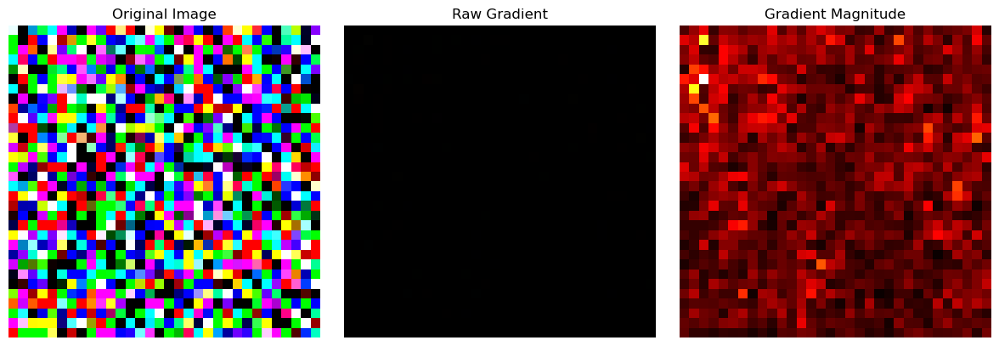

In [33]:
import torch
import torchvision.transforms as transforms
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image

def visualize_adversarial_gradient(model, image, label, epsilon=0.03, device='cuda'):
    model.eval()
    # Ensure the image has the right shape: [batch_size, channels, height, width]
    if image.dim() == 3:  # if the image is [channels, height, width], add a batch dimension
        image = image.unsqueeze(0)  # Add batch dimension: [1, channels, height, width]
    
    image = image.to(device).requires_grad_(True)  # Move to device and enable gradient tracking
    label = torch.tensor([label]).to(device)  # Convert label to tensor and move to device

    # Forward pass to compute the output of the model
    output = model(image)
    
    # Compute the loss using CrossEntropy
    loss = torch.nn.CrossEntropyLoss()(output, label)
    
    # Backpropagate the gradients
    loss.backward()

    # Get the gradient data and calculate gradient magnitude
    gradient = image.grad.data.squeeze().cpu().numpy()
    grad_magnitude = np.linalg.norm(gradient, axis=0)

    # Plotting the original image, gradient, and gradient magnitude
    plt.figure(figsize=(12, 4))
    
    # Original Image
    plt.subplot(1, 3, 1)
    plt.imshow(image.detach().squeeze().cpu().permute(1, 2, 0))  # Convert from CHW to HWC
    plt.title("Original Image")
    plt.axis("off")
    
    # Raw Gradient
    plt.subplot(1, 3, 2)
    plt.imshow(gradient.transpose(1, 2, 0))  # Transpose for proper visualization
    plt.title("Raw Gradient")
    plt.axis("off")

    # Gradient Magnitude
    plt.subplot(1, 3, 3)
    plt.imshow(grad_magnitude, cmap='hot')
    plt.title("Gradient Magnitude")
    plt.axis("off")
    
    plt.tight_layout()
    plt.show()

# Select the first adversarial example (you can change this index based on the example you want to visualize)
adversarial_example, predicted_class, _ = adv_examples_spectral[0]  # Example adversarial image
image = adversarial_example  # Adversarial image
label = predicted_class  # Adversarial example's predicted class

# Visualizing adversarial gradient for Spectral CNN
visualize_adversarial_gradient(model_spectral, image, label, device='cuda')


## 🔐 Evaluating Model Confidence of CNN and Spectral_CNN

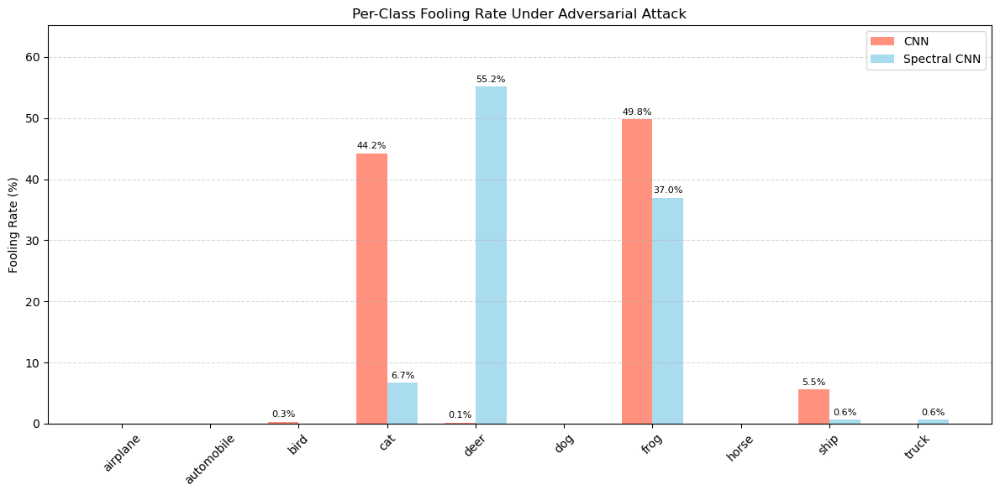

In [34]:
import matplotlib.pyplot as plt
import numpy as np

# Make sure these are defined just before plotting
T = len(adv_examples)
T_spectral = len(adv_examples_spectral)

# Recalculate fooling rates
fooling_rate_cnn = np.array([100 * class_counts.get(cls, 0) / T for cls in class_names])
fooling_rate_spectral = np.array([100 * class_counts_spectral.get(cls, 0) / T_spectral for cls in class_names])

# Plotting
plt.figure(figsize=(12, 6))
x = np.arange(len(class_names))
bar_width = 0.35

bars_cnn = plt.bar(x - bar_width/2, fooling_rate_cnn, bar_width, label='CNN', alpha=0.7, color='tomato')
bars_spectral = plt.bar(x + bar_width/2, fooling_rate_spectral, bar_width, label='Spectral CNN', alpha=0.7, color='skyblue')

# Add value labels
for bar in bars_cnn:
    height = bar.get_height()
    if height > 0:
        plt.text(bar.get_x() + bar.get_width()/2.0, height + 0.5, f'{height:.1f}%', ha='center', va='bottom', fontsize=8)

for bar in bars_spectral:
    height = bar.get_height()
    if height > 0:
        plt.text(bar.get_x() + bar.get_width()/2.0, height + 0.5, f'{height:.1f}%', ha='center', va='bottom', fontsize=8)

# Formatting
plt.xticks(x, class_names, rotation=45)
plt.ylabel("Fooling Rate (%)")
plt.title("Per-Class Fooling Rate Under Adversarial Attack")
plt.legend()
plt.grid(axis='y', linestyle='--', alpha=0.5)
plt.ylim(0, max(fooling_rate_cnn.max(), fooling_rate_spectral.max()) + 10)
plt.tight_layout()
plt.show()

In [35]:
for cls, rate_cnn, rate_spec in zip(class_names, fooling_rate_cnn, fooling_rate_spectral):
    print(f"{cls:<12} | CNN: {rate_cnn:5.2f}% | Spectral CNN: {rate_spec:5.2f}%")

airplane     | CNN:  0.00% | Spectral CNN:  0.00%
automobile   | CNN:  0.00% | Spectral CNN:  0.00%
bird         | CNN:  0.28% | Spectral CNN:  0.00%
cat          | CNN: 44.24% | Spectral CNN:  6.67%
deer         | CNN:  0.14% | Spectral CNN: 55.15%
dog          | CNN:  0.00% | Spectral CNN:  0.00%
frog         | CNN: 49.79% | Spectral CNN: 36.97%
horse        | CNN:  0.00% | Spectral CNN:  0.00%
ship         | CNN:  5.55% | Spectral CNN:  0.61%
truck        | CNN:  0.00% | Spectral CNN:  0.61%


### 🔍 Per-Class Confidence Difference Between CNN and Spectral CNN on Adversarial Examples

In [36]:
import numpy as np
from collections import defaultdict

# Initialize class-wise confidence accumulators
confidences_cnn = defaultdict(list)
confidences_spectral = defaultdict(list)

# Aggregate confidences from CNN adversarial examples
for _, predicted_class, confidence in adv_examples:
    class_name = class_names[predicted_class]
    confidences_cnn[class_name].append(confidence)

# Aggregate confidences from Spectral CNN adversarial examples
for _, predicted_class, confidence in adv_examples_spectral:
    class_name = class_names[predicted_class]
    confidences_spectral[class_name].append(confidence)

# Compute average confidence per class, in class_names order
cnn_conf_per_class = [np.mean(confidences_cnn[cls]) if confidences_cnn[cls] else 0.0 for cls in class_names]
spectral_conf_per_class = [np.mean(confidences_spectral[cls]) if confidences_spectral[cls] else 0.0 for cls in class_names]


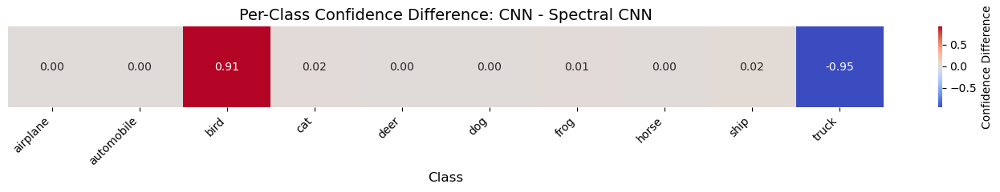

In [37]:
import seaborn as sns
import matplotlib.pyplot as plt

def plot_confidence_difference(cnn_conf_per_class, spectral_conf_per_class, class_names):
    conf_diff = np.array(cnn_conf_per_class) - np.array(spectral_conf_per_class)

    plt.figure(figsize=(14, 2.5))
    ax = sns.heatmap(conf_diff.reshape(1, -1), annot=True, fmt=".2f",
                     cmap='coolwarm', xticklabels=class_names, cbar_kws={'label': 'Confidence Difference'})

    plt.title("Per-Class Confidence Difference: CNN - Spectral CNN", fontsize=14)
    plt.yticks([], [])  # Hide y-axis ticks
    plt.xticks(rotation=45, ha='right')
    plt.xlabel("Class", fontsize=12)
    plt.tight_layout()
    plt.show()

# Call it with real values
plot_confidence_difference(cnn_conf_per_class, spectral_conf_per_class, class_names)

### 🌀 Model Confidence on Random Noise Inputs: CNN vs Spectral CNN

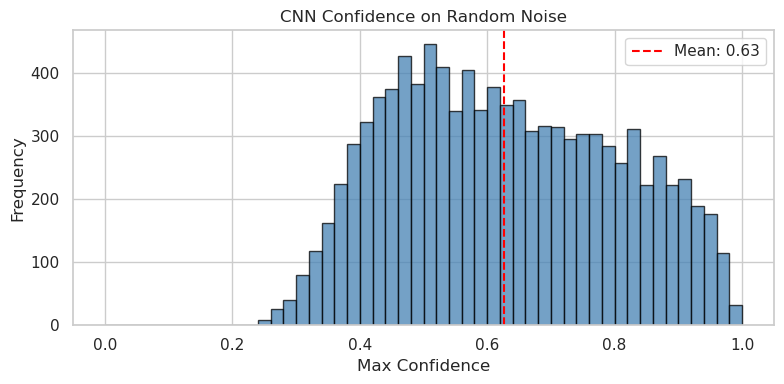

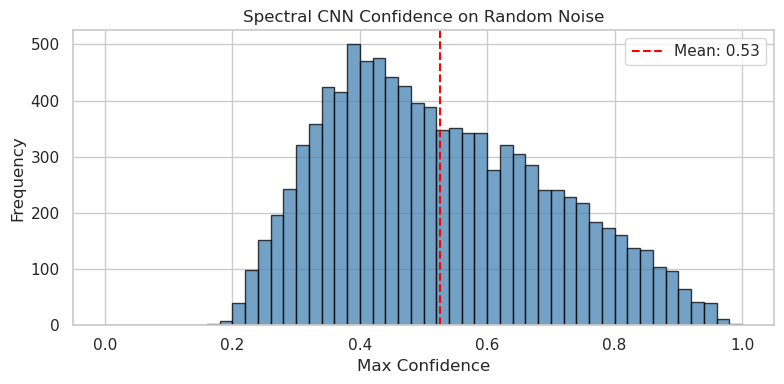

In [38]:
import torch
import torch.nn.functional as F
import matplotlib.pyplot as plt
import seaborn as sns
from PIL import Image
import numpy as np

sns.set(style='whitegrid')

def plot_confidence_histogram(model, transform_test, device, num_attempts=10000, title='Confidence Histogram'):
    model.eval()
    confidences = []

    for _ in range(num_attempts):
        noise_image = torch.rand(1, 3, 32, 32)
        noise_image = noise_image.squeeze(0).permute(1, 2, 0).numpy()
        noise_image = (noise_image * 255).astype(np.uint8)
        noise_image = Image.fromarray(noise_image)
        noise_image = transform_test(noise_image).unsqueeze(0).to(device)

        with torch.no_grad():
            output = model(noise_image)
            probs = F.softmax(output, dim=1)
            confidences.append(torch.max(probs).item())

    # Plot
    plt.figure(figsize=(8, 4))
    plt.hist(confidences, bins=50, range=(0, 1), color='steelblue', alpha=0.75, edgecolor='black')
    plt.axvline(np.mean(confidences), color='red', linestyle='--', label=f'Mean: {np.mean(confidences):.2f}')
    plt.title(title)
    plt.xlabel('Max Confidence')
    plt.ylabel('Frequency')
    plt.legend()
    plt.tight_layout()
    plt.show()

    return confidences

confidences_cnn = plot_confidence_histogram(model_CNN, transform_test, device, title='CNN Confidence on Random Noise')
confidences_spectral = plot_confidence_histogram(model_spectral, transform_test, device, title='Spectral CNN Confidence on Random Noise')

### Comparing distribution of confidence through box plot

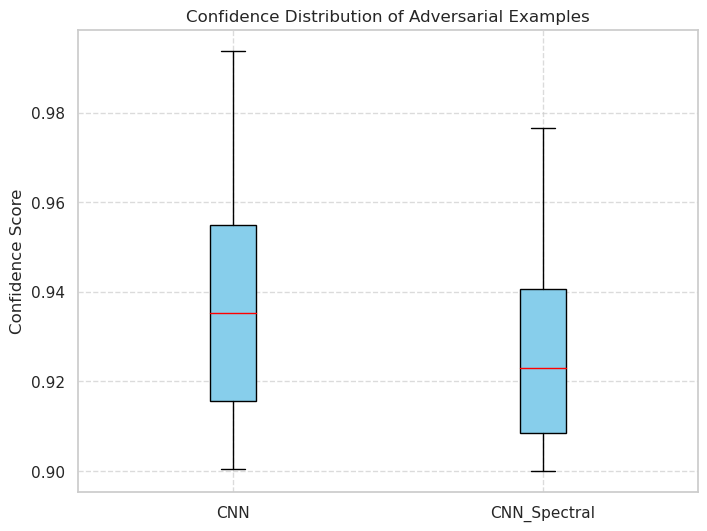

In [39]:
import matplotlib.pyplot as plt

def plot_confidence_box_simple(adv_examples, adv_examples_spectral):
    original_probs = [prob for _, _, prob in adv_examples]
    spectral_probs = [prob for _, _, prob in adv_examples_spectral]

    # Box plot
    data = [original_probs, spectral_probs]
    labels = ['CNN', 'CNN_Spectral']

    plt.figure(figsize=(8, 6))
    plt.boxplot(data, labels=labels, patch_artist=True,
                boxprops=dict(facecolor='skyblue'),
                medianprops=dict(color='red'),
                flierprops=dict(markerfacecolor='orange', marker='o', markersize=5))

    plt.title('Confidence Distribution of Adversarial Examples')
    plt.ylabel('Confidence Score')
    plt.grid(True, linestyle='--', alpha=0.7)
    plt.show()

# Call the function
plot_confidence_box_simple(adv_examples, adv_examples_spectral)


### 📊 Adversarial Class Prediction Distribution: CNN vs Spectral CNN

In [40]:
import plotly.graph_objects as go
import numpy as np

def plot_class_distribution(adv1, adv2, class_names, title='Class Prediction Distribution'):
    def count_preds(examples, num_classes):  # quick helper
        counts = np.zeros(num_classes, dtype=int)
        for _, pred, _ in examples: counts[pred] += 1
        return counts

    counts1 = count_preds(adv1, len(class_names))
    counts2 = count_preds(adv2, len(class_names))

    fig = go.Figure([
        go.Bar(x=class_names, y=counts1, name='CNN', marker_color='#1f77b4', text=counts1, textposition='auto'),
        go.Bar(x=class_names, y=counts2, name='CNN_Spectral', marker_color='#ff7f0e', text=counts2, textposition='auto')
    ])

    fig.update_layout(
        title=title,
        xaxis_title='Class',
        yaxis_title='Adversarial Example Count',
        barmode='group',
        bargap=0.05,
        bargroupgap=0.02,
        xaxis_tickangle=-35,
        template='plotly_white'
    )
    fig.show()

# Usage
plot_class_distribution(adv_examples, adv_examples_spectral, class_names)

### 🎯 Confidence Scores vs. Predicted Classes: CNN vs Spectral CNN

In [41]:
def plot_confidence_scatter(adv1, adv2, class_names, title='Confidence vs. Class'):
    def get_data(adv): return zip(*[(p, c) for _, p, c in adv])

    preds1, confs1 = get_data(adv1)
    preds2, confs2 = get_data(adv2)

    fig = go.Figure([
        go.Scatter(x=preds1, y=confs1, mode='markers', name='CNN',
                   marker=dict(color='royalblue', size=9, opacity=0.6),
                   text=[f'{class_names[p]} ({c:.3f})' for p, c in zip(preds1, confs1)]),
        go.Scatter(x=preds2, y=confs2, mode='markers', name='CNN_Spectral',
                   marker=dict(color='orangered', size=9, opacity=0.6),
                   text=[f'{class_names[p]} ({c:.3f})' for p, c in zip(preds2, confs2)])
    ])

    fig.update_layout(
        title=title,
        xaxis=dict(title='Predicted Class', tickvals=list(range(len(class_names))),
                   ticktext=class_names, tickangle=-40),
        yaxis=dict(title='Confidence Score', range=[0.9, 1.0]),
        template='plotly_white',
        margin=dict(l=50, r=30, t=50, b=70)
    )
    fig.show()

# Call it as usual
plot_confidence_scatter(adv_examples, adv_examples_spectral, class_names)

### Noise vs Test set distribution of succesful attempst of CNN model across classes

In [42]:
def plot_noise_vs_test_distribution(model, test_loader, adv_examples, class_names, title='Noise vs. Test Predictions'):
    with torch.no_grad():
        test_preds = [pred.item() for inputs, _ in test_loader for pred in torch.argmax(model(inputs.to(device)), 1).cpu()]

    noise_preds = [pred for _, pred, _ in adv_examples]
    test_counts, noise_counts = np.bincount(test_preds, minlength=10), np.bincount(noise_preds, minlength=10)

    fig = go.Figure([
        go.Bar(x=class_names, y=test_counts, name='Test Set', marker_color='mediumseagreen', text=test_counts, textposition='outside'),
        go.Bar(x=class_names, y=noise_counts, name='Adversarial Noise', marker_color='darkorange', text=noise_counts, textposition='outside')
    ])

    fig.update_layout(
        title=title,
        xaxis=dict(title='Classes', tickangle=-30, tickfont=dict(size=11)),
        yaxis_title='Prediction Count',
        barmode='group',
        bargap=0.05,
        bargroupgap=0.02,
        template='plotly_white',
        legend=dict(x=0.75, y=0.95)
    )
    fig.show()

In [43]:
plot_noise_vs_test_distribution(model_CNN, test_loader, adv_examples, class_names, 'CNN: Noise vs. Test')

In [44]:
plot_noise_vs_test_distribution(model_spectral, test_loader, adv_examples_spectral, class_names, 'CNN_Spectral: Noise vs. Test')

### 📊 Total Number of Adversarial Examples: CNN vs Spectral CNN

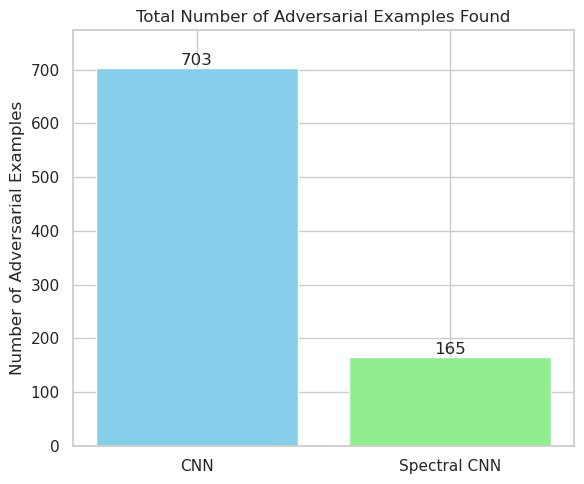

In [45]:
import matplotlib.pyplot as plt

# Total adversarial examples from both models
model_names = ['CNN', 'Spectral CNN']
total_adversarials = [N, N_spectral]

# Bar plot
plt.figure(figsize=(6, 5))
bars = plt.bar(model_names, total_adversarials, color=['skyblue', 'lightgreen'])

# Add values on top of bars
for bar in bars:
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2., height + 1, '%d' % int(height), ha='center', va='bottom')

# Plot settings
plt.title('Total Number of Adversarial Examples Found')
plt.ylabel('Number of Adversarial Examples')
plt.ylim(0, max(total_adversarials) * 1.1)

plt.tight_layout()
plt.show()